/tmp/ipykernel_2802158/4179398272.py:52: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  stats_df = pd.concat([stats_df, temp_df], ignore_index=True)


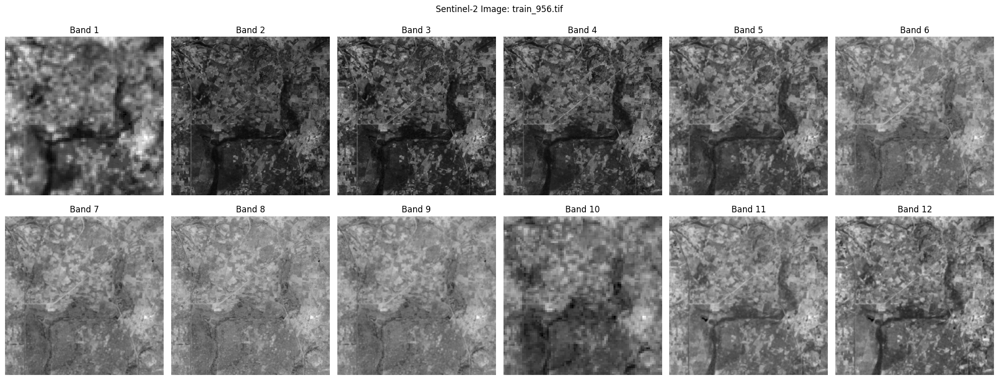

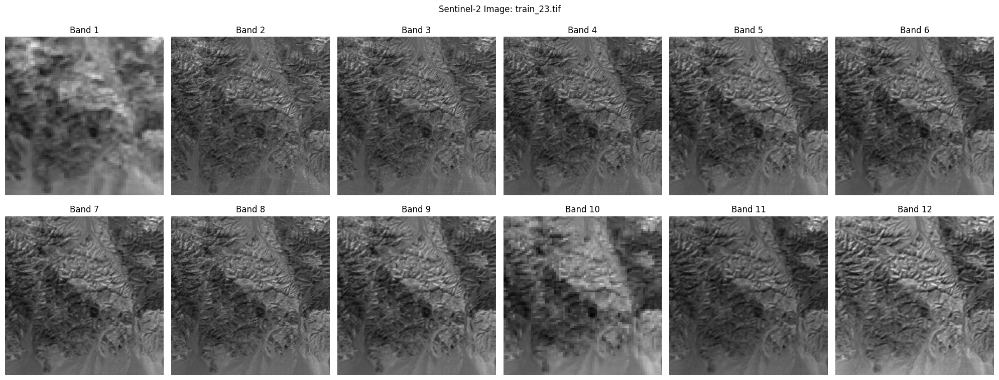

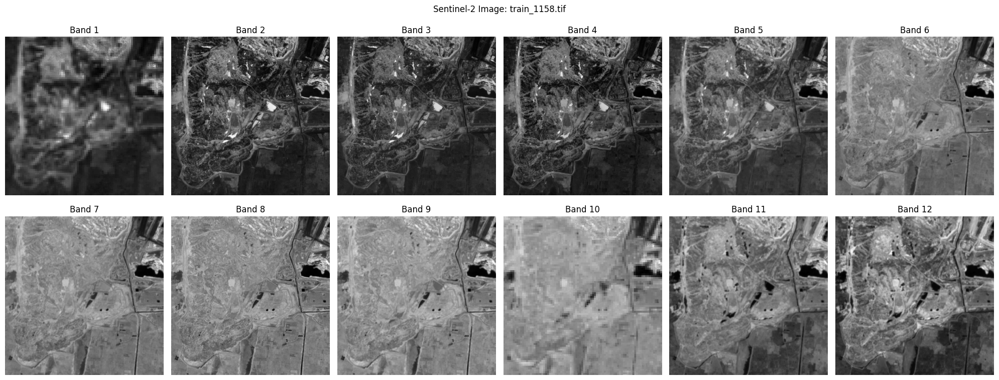

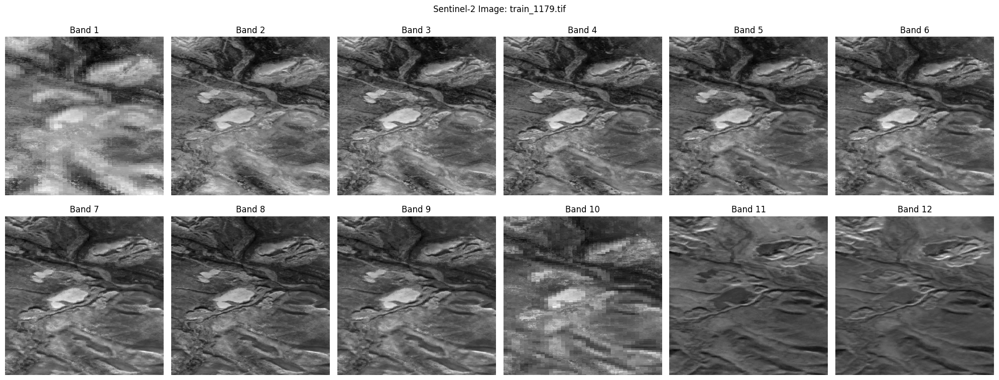

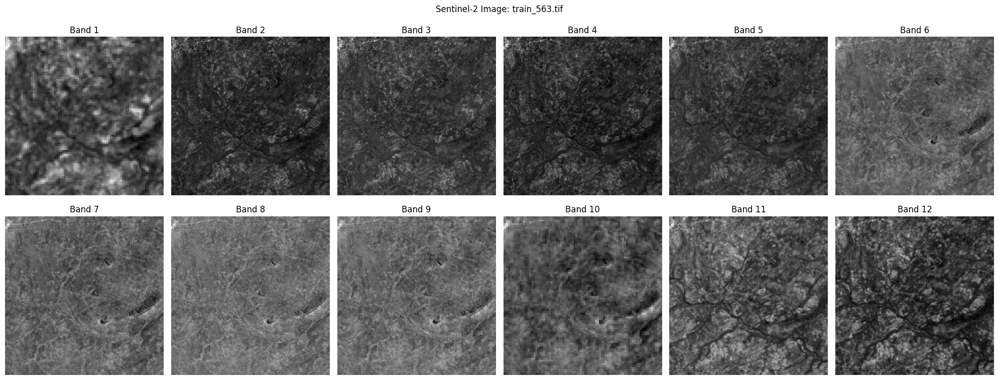

...

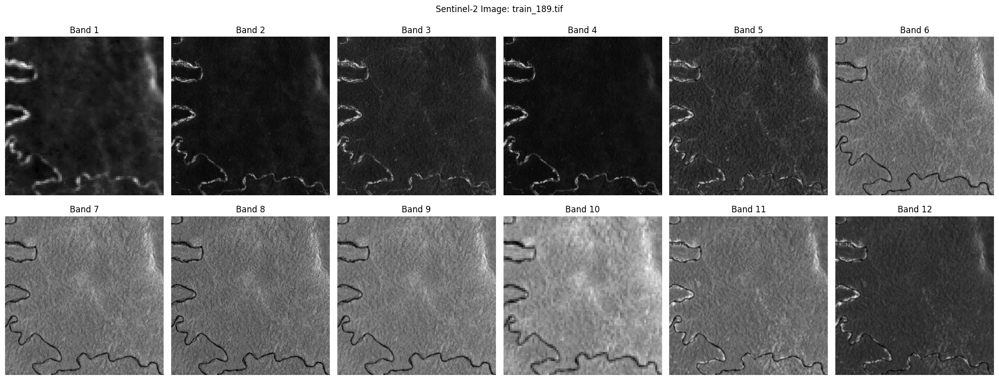

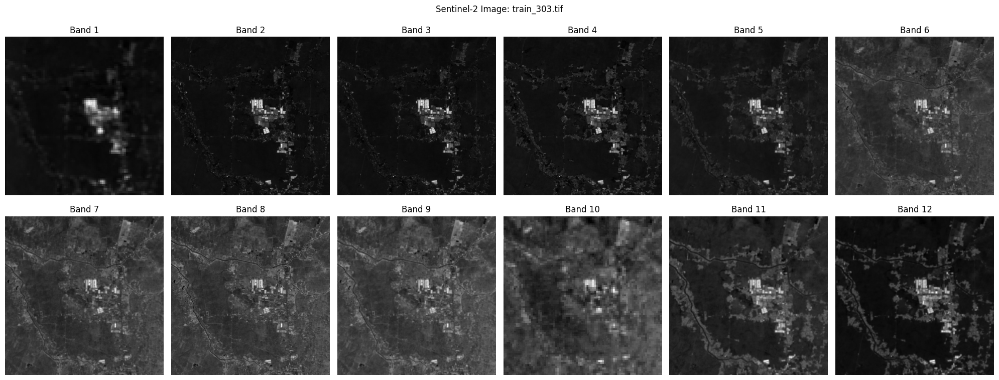

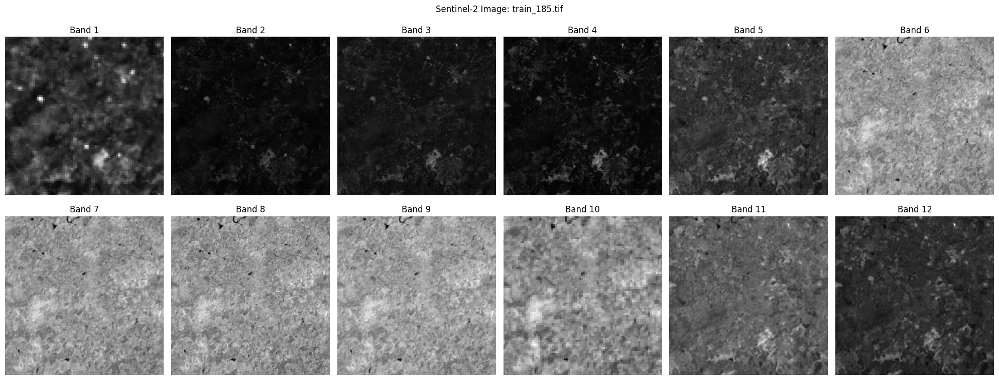

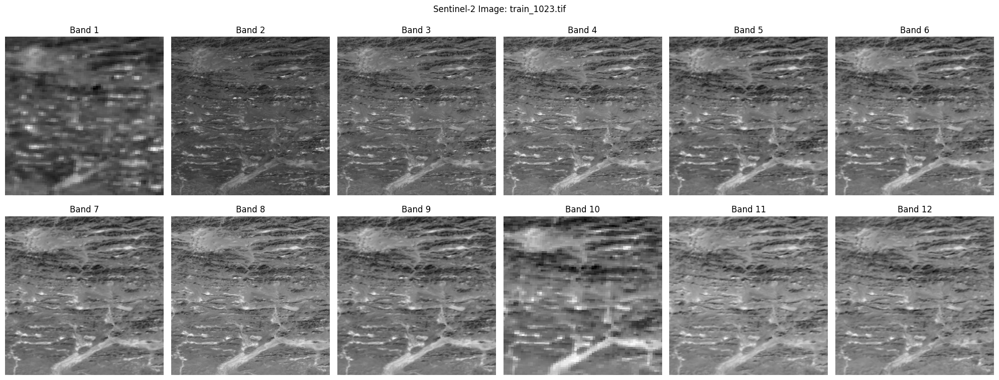

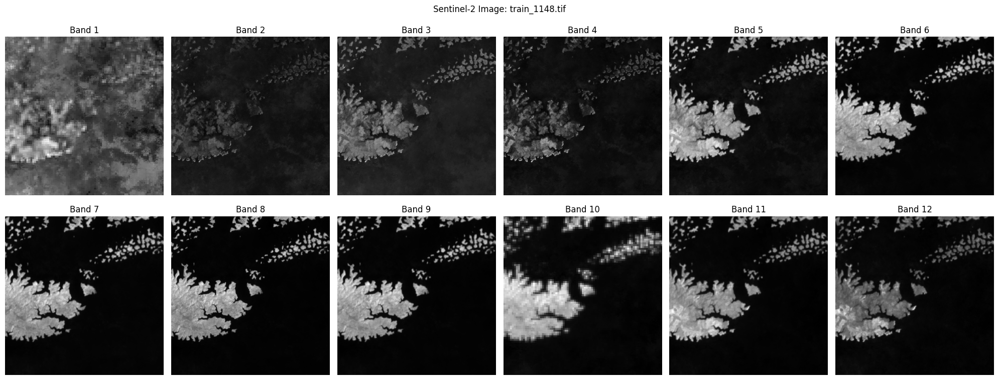

In [9]:
import os
import tifffile as tiff
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Set the path to the training data directory
train_dir = "data/train/train"

# Get a list of all the TIFF files in the directory
tiff_files = [f for f in os.listdir(train_dir) if f.endswith(".tif")]

# Create a DataFrame to store the image statistics
stats_df = pd.DataFrame(columns=["Filename", "Band", "Min", "Max", "Mean", "Std"])

# Check if there are any TIFF files in the directory
if len(tiff_files) > 0:
    # Iterate over each TIFF file
    for tiff_file in tiff_files:
        # Read the TIFF file using tifffile
        img_data = tiff.imread(os.path.join(train_dir, tiff_file))
        
        # Get the number of bands in the image
        num_bands = img_data.shape[2]
        
        # Create a list to store the statistics for each band
        band_stats = []
        
        # Iterate over each band
        for band in range(num_bands):
            # Get the band data
            band_data = img_data[:, :, band]
            
            # Calculate statistics for the band
            min_value = np.min(band_data)
            max_value = np.max(band_data)
            mean_value = np.mean(band_data)
            std_value = np.std(band_data)
            
            # Append the statistics to the band_stats list
            band_stats.append({"Filename": tiff_file,
                               "Band": f"B{band+1}",
                               "Min": min_value,
                               "Max": max_value,
                               "Mean": mean_value,
                               "Std": std_value})
        
        # Create a temporary DataFrame from the band_stats list
        temp_df = pd.DataFrame(band_stats)
        
        # Concatenate the temporary DataFrame with the main DataFrame
        stats_df = pd.concat([stats_df, temp_df], ignore_index=True)
        
        # Visualize the image bands
        fig, axes = plt.subplots(2, 6, figsize=(20, 8))
        axes = axes.flatten()
        
        for band in range(num_bands):
            axes[band].imshow(img_data[:, :, band], cmap='gray')
            axes[band].set_title(f"Band {band+1}")
            axes[band].axis('off')
        
        plt.suptitle(f"Sentinel-2 Image: {tiff_file}")
        plt.tight_layout()
        plt.show()
    
    # Print the statistics DataFrame
    print(stats_df)
    
    # Plot histograms of pixel values for each band
    for band in range(num_bands):
        plt.figure(figsize=(8, 6))
        plt.hist(img_data[:, :, band].flatten(), bins=50)
        plt.xlabel("Pixel Value")
        plt.ylabel("Frequency")
        plt.title(f"Histogram of Band {band+1}")
        plt.show()
else:
    print("No TIFF files found in the specified directory.")

In [1]:
import os
import tifffile as tiff
import numpy as np

# Set the path to the training data directory
train_dir = "data/train/train"

# Get a list of all the TIFF files in the directory
tiff_files = [f for f in os.listdir(train_dir) if f.endswith(".tif")]

# Check if there are any TIFF files in the directory
if len(tiff_files) > 0:
    # Initialize variables to store dimensions
    first_image_dims = None
    all_images_same_dims = True
    
    # Iterate over each TIFF file
    for tiff_file in tiff_files:
        # Read the TIFF file using tifffile
        img_data = tiff.imread(os.path.join(train_dir, tiff_file))
        
        # Get the number of bands in the image
        num_bands = img_data.shape[2]
        
        # Print the dimensions of each band
        print(f"Image: {tiff_file}")
        for band in range(num_bands):
            band_dims = img_data[:, :, band].shape
            print(f"Band {band+1} dimensions: {band_dims}")
        
        # Check if all images have the same dimensions
        if first_image_dims is None:
            first_image_dims = img_data.shape
        elif img_data.shape != first_image_dims:
            all_images_same_dims = False
            print(f"Warning: Image {tiff_file} has different dimensions than the first image.")
        
        print("---")
    
    # Print the verification result
    if all_images_same_dims:
        print("All images have the same dimensions.")
    else:
        print("Not all images have the same dimensions.")
else:
    print("No TIFF files found in the specified directory.")

Image: train_956.tif
Band 1 dimensions: (512, 512)
Band 2 dimensions: (512, 512)
Band 3 dimensions: (512, 512)
Band 4 dimensions: (512, 512)
Band 5 dimensions: (512, 512)
Band 6 dimensions: (512, 512)
Band 7 dimensions: (512, 512)
Band 8 dimensions: (512, 512)
Band 9 dimensions: (512, 512)
Band 10 dimensions: (512, 512)
Band 11 dimensions: (512, 512)
Band 12 dimensions: (512, 512)
---
Image: train_23.tif
Band 1 dimensions: (512, 512)
Band 2 dimensions: (512, 512)
Band 3 dimensions: (512, 512)
Band 4 dimensions: (512, 512)
Band 5 dimensions: (512, 512)
Band 6 dimensions: (512, 512)
Band 7 dimensions: (512, 512)
Band 8 dimensions: (512, 512)
Band 9 dimensions: (512, 512)
Band 10 dimensions: (512, 512)
Band 11 dimensions: (512, 512)
Band 12 dimensions: (512, 512)
---
Image: train_1158.tif
Band 1 dimensions: (512, 512)
Band 2 dimensions: (512, 512)
Band 3 dimensions: (512, 512)
Band 4 dimensions: (512, 512)
Band 5 dimensions: (512, 512)
Band 6 dimensions: (512, 512)
Band 7 dimensions: (512